In [242]:
import numpy as np
import uncertainties as unc
from matplotlib import pyplot as plt
from uncertainties import unumpy as unp
import matplotlib.gridspec as gs
from uncertainties.umath import *
import scipy.odr as odr
from scipy.special import jv
from numpy.fft import *
from scipy import ndimage
import matplotlib.image as mpimg
from scipy import misc
import os
from skimage.measure import compare_ssim
import glob
from numba import jit
from mpl_toolkits.axes_grid1.inset_locator import inset_axes
from scipy.signal import fftconvolve, convolve

c = 299792458 # speed of light in m/s
pi = np.pi

In [200]:
def decompose(unparray):
    return np.array([unp.nominal_values(unparray), unp.std_devs(unparray)])

def errorplot(xarray, yarray, xlabel, ylabel):
    xnom, xerr = decompose(xarray)
    ynom, yerr = decompose(yarray)
    fig, ax = plt.subplots(figsize = (10, 7))
    ax.errorbar(xnom, ynom, xerr = xerr, yerr = yerr, fmt = 'o', capsize = 2)
    ax.set_xlabel(xlabel, fontsize = 18)
    ax.set_ylabel(ylabel, fontsize = 18)
    ax.grid(True)
    plt.show()
    return

def findfit(xarray, yarray, func, beta0, showout = False, err = True):
    model = odr.Model(func)
    if err:
        xnom, xerr = decompose(xarray)
        ynom, yerr = decompose(yarray)
        data = odr.RealData(xnom, ynom, sx = xerr, sy = yerr)
        odrfit = odr.ODR(data, model, beta0 = beta0)
        out = odrfit.run()
    else:
        data = odr.RealData(xarray, yarray)
        odrfit = odr.ODR(data, model, beta0 = beta0)
        out = odrfit.run()
    if showout:
        out.pprint()
        print(out.sum_square)
    return np.array([out.beta, out.sd_beta])

def errorfitplot(xarray, yarray, xlabel, ylabel, func, fitparam, colors = ['blue', 'red'], offset = 0, err = True):
    if err:
        xnom, xerr = decompose(xarray)
        ynom, yerr = decompose(yarray)
        if xnom[0] <= xnom[-1]:
            fitx = np.linspace(xnom[0]-offset, xnom[-1] + offset, 500)
        else:
            fitx = np.linspace(xnom[0]+offset, xnom[-1] - offset, 500)
        fity = func(fitparam, fitx)
        fig, ax = plt.subplots(figsize = (10, 7))
        ax.errorbar(xnom, ynom, xerr = xerr, yerr = yerr, fmt = 'o', capsize = 2, color = colors[0])
    else:
        if xarray[0] <= xarray[-1]:
            fitx = np.linspace(xarray[0]-offset, xarray[-1] + offset, 500)
        else:
            fitx = np.linspace(xarray[0]+offset, xarray[-1] - offset, 500)
        fity = func(fitparam, fitx)
        fig, ax = plt.subplots(figsize = (10, 7))
        ax.plot(xarray, yarray, color = colors[0])
    ax.plot(fitx, fity, color = colors[1])
    ax.set_xlabel(xlabel, fontsize = 16)
    ax.set_ylabel(ylabel, fontsize = 16)
    ax.grid(True)
    plt.show()
    return

def extractparam(param):
    l = []
    for n in range(len(param.T)):
        p = unc.ufloat(param.T[n][0], param.T[n][1])
        l.append(p)
    return l

def linear(B, x):
    return B[0]*x + B[1]

5A: Diffraction from various apertures and objects

In [245]:
os.chdir("/home/gian/Documents/School/Grad School/Fall 2017/PHYS 3330/Lab 5/Pics/Cropped/")

In [202]:
def singleslit(a, y, d, l):    
    I = np.sinc(a*y/(l*np.sqrt(y**2+d**2)))**2
    return I

def singleslitm(B, y):
    scale, offset = B
    y = (y + offset)*scale
    I = np.sinc(a*y/(l*np.sqrt(y**2+d**2)))**2
    return I

def singleslitm2(B, y):
    offset = B[0]
    y = (y + offset)
    I = np.sinc(a*y/(l*np.sqrt(y**2+d**2)))**2
    return I

def offsetm(B, x):
    return B[0]+x

In [203]:
image = misc.imread('singleslit.08mm.png', mode = 'L').mean(axis = 0)
image = image - min(image)
image = image/max(image)
y = np.linspace(-4, 4, len(image))
a = 0.08e-1
d = 41.
l = 632.8e-7
p = findfit(y, image, singleslitm, [2, 0], showout = True, err = False)

Beta: [ 0.38840538  0.05430198]
Beta Std Error: [ 0.0028548   0.00367741]
Beta Covariance: [[  2.04496742e-03   1.72296890e-05]
 [  1.72296890e-05   3.39326087e-03]]
Residual Variance: 0.00398534500165
Inverse Condition #: 0.0831096802843
Reason(s) for Halting:
  Sum of squares convergence
9.26194178383


In [204]:
y = np.linspace(-3., 3., len(image))
p = findfit(y, image, singleslitm2, [0], showout = True, err = False)

Beta: [ 0.02401093]
Beta Std Error: [ 0.00518307]
Beta Covariance: [[ 0.00397502]]
Residual Variance: 0.0067582726494
Inverse Condition #: 1.0
Reason(s) for Halting:
  Sum of squares convergence
15.7129839099


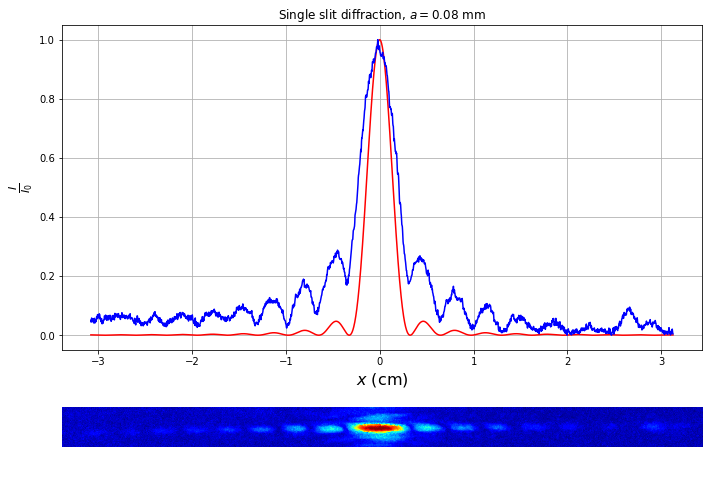

In [207]:
y = np.linspace(-3.1, 3.1, len(image)) + p[0]
I = singleslit(0.08e-1, y, 41., 632.8e-7)
fig = plt.figure(figsize = (10, 7))
gspec = gs.GridSpec(2, 1, height_ratios = [4, 1])
ax0 = plt.subplot(gspec[0])
ax1 = plt.subplot(gspec[1])
ax0.plot(y, I, c = 'red')
ax0.plot(y, image, c = 'blue')
ax0.set_ylabel(r'$\frac{I}{I_0}$', fontsize = 16)
ax0.set_xlabel(r'$x$ (cm)', fontsize = 16)
ax0.grid(True)
ax0.set_title(r'Single slit diffraction, $a=0.08$ mm')
ax1.imshow(misc.imread('singleslit.08mm.png', mode = 'L'), cmap = 'jet')
ax1.set_axis_off()
ax1.set_xlabel(r'$x$ (cm)', fontsize = 16)
plt.tight_layout()
plt.show()

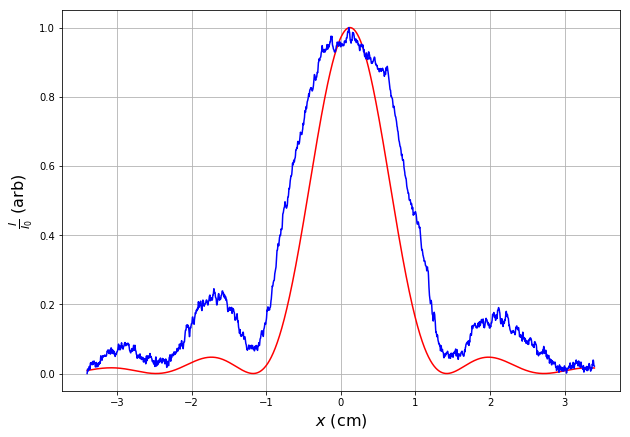

In [209]:
image = misc.imread('singleslit.02mm.png', mode = 'L').mean(axis = 0)
image = image - min(image)
image = image/max(image)
y = np.linspace(-3.4, 3.4, len(image))
a = 0.02e-1
p = findfit(y, image, singleslitm2, [0], err = False)
I = singleslit(0.02e-1, y + p[0], 41., 632.8e-7)
fig, ax = plt.subplots(figsize = (10, 7))
ax.plot(y, I, c = 'red')
ax.plot(y, image, c = 'blue')
ax.set_xlabel(r'$x$ (cm)', fontsize = 16)
ax.set_ylabel(r'$\frac{I}{I_0}$ (arb)', fontsize = 16)
ax.grid(True)
plt.show()

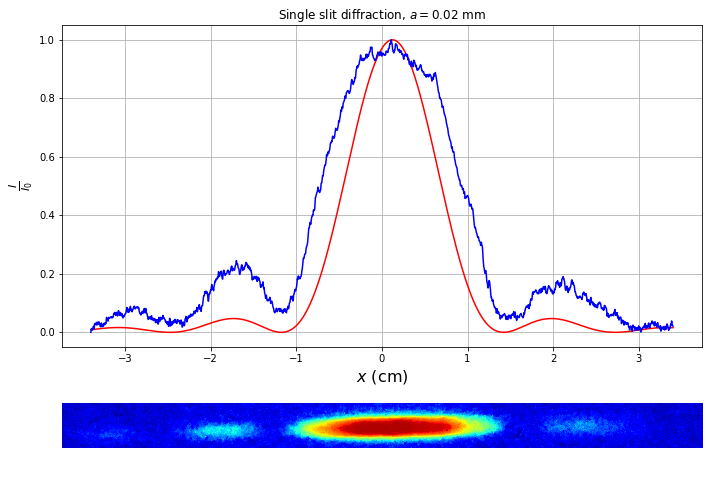

In [210]:
fig = plt.figure(figsize = (10, 7))
gspec = gs.GridSpec(2, 1, height_ratios = [4, 1])
ax0 = plt.subplot(gspec[0])
ax1 = plt.subplot(gspec[1])
ax0.plot(y, I, c = 'red')
ax0.plot(y, image, c = 'blue')
ax0.set_ylabel(r'$\frac{I}{I_0}$', fontsize = 16)
ax0.set_xlabel(r'$x$ (cm)', fontsize = 16)
ax0.grid(True)
ax0.set_title(r'Single slit diffraction, $a=0.02$ mm')
ax1.imshow(misc.imread('singleslit.02mm.png', mode = 'L'), cmap = 'jet')
ax1.set_axis_off()
ax1.set_xlabel(r'$x$ (cm)', fontsize = 16)
plt.tight_layout()
plt.show()

Beta: [ 0.12647081]
Beta Std Error: [ 0.00592337]
Beta Covariance: [[ 0.00293774]]
Residual Variance: 0.0119432657374
Inverse Condition #: 1.0
Reason(s) for Halting:
  Sum of squares convergence
26.5498797343


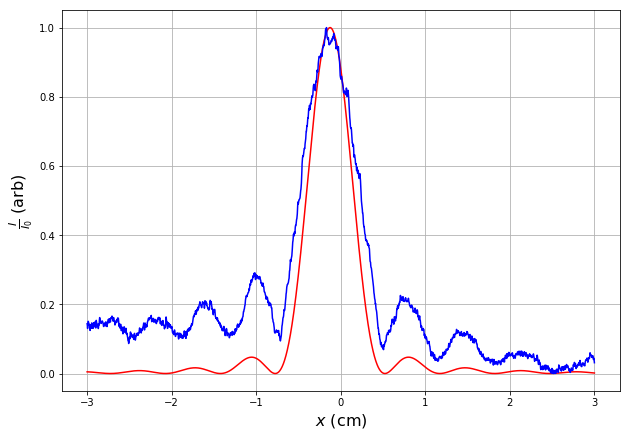

In [211]:
image = misc.imread('singleslit.04mm.png', mode = 'L').mean(axis = 0)
image = image - min(image)
image = image/max(image)
m = 3.
y = np.linspace(-m, m, len(image))
a = 0.04e-1
p = findfit(y, image, singleslitm2, [0], showout = True, err = False)
I = singleslit(0.04e-1, y + p[0], 41., 632.8e-7)
fig, ax = plt.subplots(figsize = (10, 7))
ax.plot(y, I, c = 'red')
ax.plot(y, image, c = 'blue')
ax.set_xlabel(r'$x$ (cm)', fontsize = 16)
ax.set_ylabel(r'$\frac{I}{I_0}$ (arb)', fontsize = 16)
ax.grid(True)
plt.show()

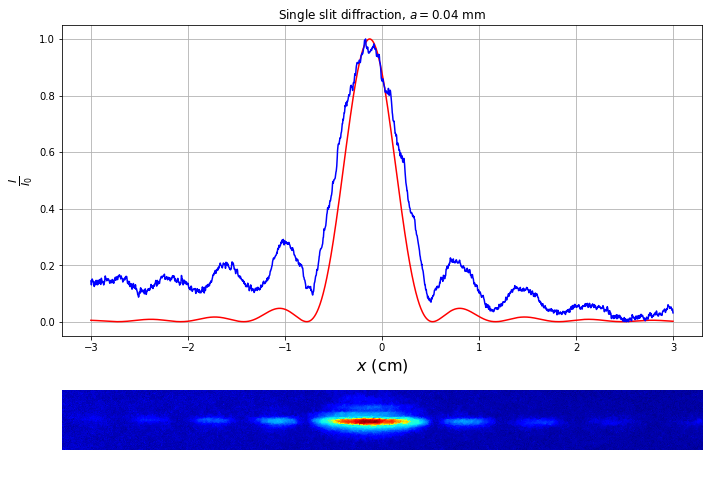

In [212]:
fig = plt.figure(figsize = (10, 7))
gspec = gs.GridSpec(2, 1, height_ratios = [4, 1])
ax0 = plt.subplot(gspec[0])
ax1 = plt.subplot(gspec[1])
ax0.plot(y, I, c = 'red')
ax0.plot(y, image, c = 'blue')
ax0.set_ylabel(r'$\frac{I}{I_0}$', fontsize = 16)
ax0.set_xlabel(r'$x$ (cm)', fontsize = 16)
ax0.grid(True)
ax0.set_title(r'Single slit diffraction, $a=0.04$ mm')
ax1.imshow(misc.imread('singleslit.04mm.png', mode = 'L'), cmap = 'jet')
ax1.set_axis_off()
ax1.set_xlabel(r'$x$ (cm)', fontsize = 16)
plt.tight_layout()
plt.show()

In [186]:
def nslits(a, y, d, l, N, b):
    alpha = b*pi*y/(l*np.sqrt(y**2+d**2))
    I = singleslit(a, y, d, l)*(np.sin(N*alpha)/(np.sin(alpha)*N))**2
    return I

def nslitsm(B, y):
    scale, offset = B
    y = (y + offset)*scale
    alpha = b*pi*y/(l*np.sqrt(y**2+d**2))
    I = singleslit(a, y, d, l)*(np.sin(N*alpha)/np.sin(alpha))**2
    return I

def nslitsm2(B, y):
    offset = B[0]
    y = (y + offset)
    alpha = b*pi*y/(l*np.sqrt(y**2+d**2))
    I = singleslit(a, y, d, l)*(np.sin(N*alpha)/np.sin(alpha))**2
    return I

/usr/local/anaconda2/lib/python2.7/site-packages/ipykernel_launcher.py:3: RuntimeWarning: invalid value encountered in divide
  This is separate from the ipykernel package so we can avoid doing imports until


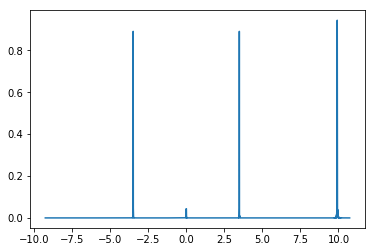

In [198]:
m = 10
y = np.linspace(-m, m, len(image))
y = y - y[np.argmax(image)]
a = 1e-5
b = 1e-1/600.
N = 600
I = nslits(a, y, 8.5, 632.8e-7, N, b)
plt.plot(y, I)
plt.show()

/usr/local/anaconda2/lib/python2.7/site-packages/ipykernel_launcher.py:3: RuntimeWarning: invalid value encountered in divide
  This is separate from the ipykernel package so we can avoid doing imports until


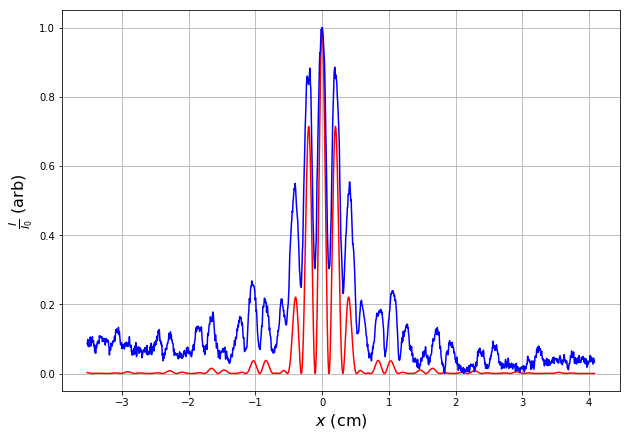

In [246]:
image = misc.imread('2slit.png', mode = 'L').mean(axis = 0)
image = image - min(image)
image = image/max(image)
m = 3.8
y = np.linspace(-m, m, len(image))
y = y - y[np.argmax(image)]
a = 0.04e-1
b = 0.125e-1
N = 2
I = nslits(a, y, 41., 632.8e-7, N, b)
fig, ax = plt.subplots(figsize = (10, 7))
ax.plot(y, I, c = 'red')
ax.plot(y, image, c = 'blue')
ax.set_xlabel(r'$x$ (cm)', fontsize = 16)
ax.set_ylabel(r'$\frac{I}{I_0}$ (arb)', fontsize = 16)
ax.grid(True)
plt.show()

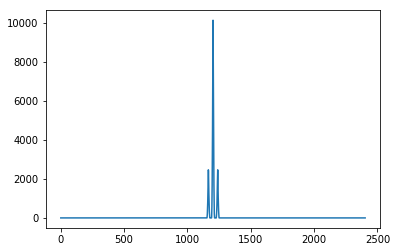

In [259]:
ft = fftshift(fft(I))
ft2 = fftshift(fft(image))
plt.plot(range(len(ft)), np.abs(ft)**2)
#plt.plot(range(len(ft2)), np.abs(ft2)**2)
plt.show()

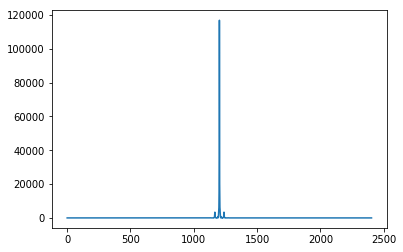

In [261]:
plt.plot(range(len(ft2)), np.abs(ft2)**2)
plt.show()

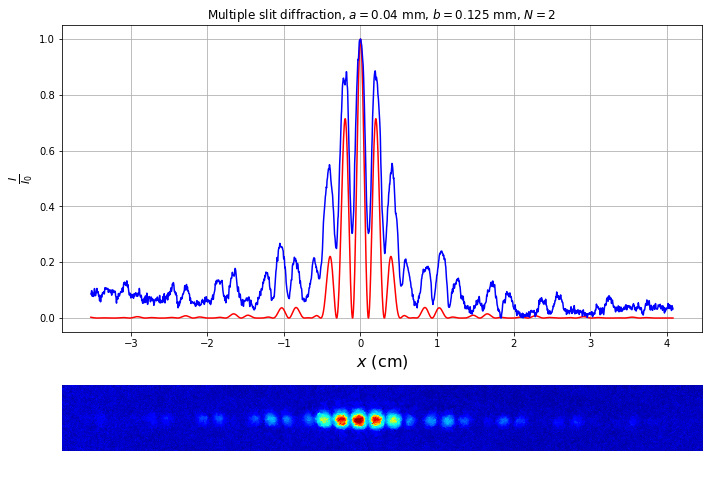

In [214]:
fig = plt.figure(figsize = (10, 7))
gspec = gs.GridSpec(2, 1, height_ratios = [4, 1])
ax0 = plt.subplot(gspec[0])
ax1 = plt.subplot(gspec[1])
ax0.plot(y, I, c = 'red')
ax0.plot(y, image, c = 'blue')
ax0.set_ylabel(r'$\frac{I}{I_0}$', fontsize = 16)
ax0.set_xlabel(r'$x$ (cm)', fontsize = 16)
ax0.grid(True)
ax0.set_title(r'Multiple slit diffraction, $a=0.04$ mm, $b=0.125$ mm, $N=2$')
ax1.imshow(misc.imread('2slit.png', mode = 'L'), cmap = 'jet')
ax1.set_axis_off()
ax1.set_xlabel(r'$x$ (cm)', fontsize = 16)
plt.tight_layout()
plt.show()

/usr/local/anaconda2/lib/python2.7/site-packages/ipykernel_launcher.py:3: RuntimeWarning: invalid value encountered in divide
  This is separate from the ipykernel package so we can avoid doing imports until


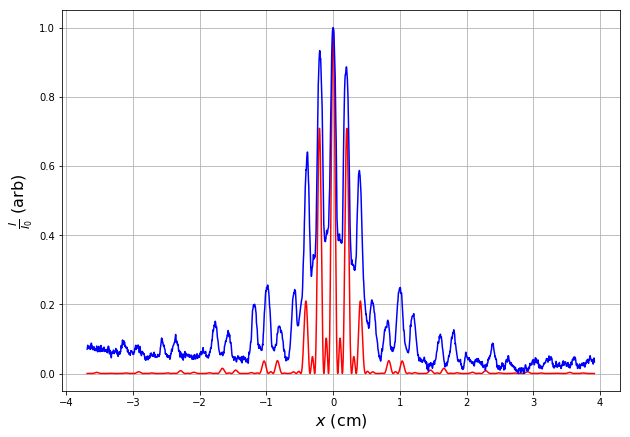

In [215]:
image = misc.imread('3slit.png', mode = 'L').mean(axis = 0)
image = image - min(image)
image = image/max(image)
m = 3.8
y = np.linspace(-m, m, len(image))
y = y - y[np.argmax(image)]
a = 0.04e-1
b = 0.125e-1
N = 3
I = nslits(a, y , 41., 632.8e-7, N, b)
fig, ax = plt.subplots(figsize = (10, 7))
ax.plot(y, I, c = 'red')
ax.plot(y, image, c = 'blue')
ax.set_xlabel(r'$x$ (cm)', fontsize = 16)
ax.set_ylabel(r'$\frac{I}{I_0}$ (arb)', fontsize = 16)
ax.grid(True)
plt.show()

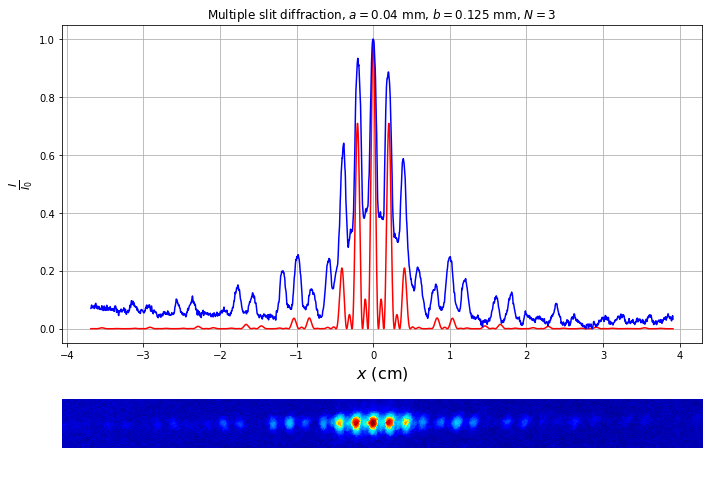

In [216]:
fig = plt.figure(figsize = (10, 7))
gspec = gs.GridSpec(2, 1, height_ratios = [4, 1])
ax0 = plt.subplot(gspec[0])
ax1 = plt.subplot(gspec[1])
ax0.plot(y, I, c = 'red')
ax0.plot(y, image, c = 'blue')
ax0.set_ylabel(r'$\frac{I}{I_0}$', fontsize = 16)
ax0.set_xlabel(r'$x$ (cm)', fontsize = 16)
ax0.grid(True)
ax0.set_title(r'Multiple slit diffraction, $a=0.04$ mm, $b=0.125$ mm, $N=3$')
ax1.imshow(misc.imread('3slit.png', mode = 'L'), cmap = 'jet')
ax1.set_axis_off()
ax1.set_xlabel(r'$x$ (cm)', fontsize = 16)
plt.tight_layout()
plt.show()

/usr/local/anaconda2/lib/python2.7/site-packages/ipykernel_launcher.py:3: RuntimeWarning: invalid value encountered in divide
  This is separate from the ipykernel package so we can avoid doing imports until


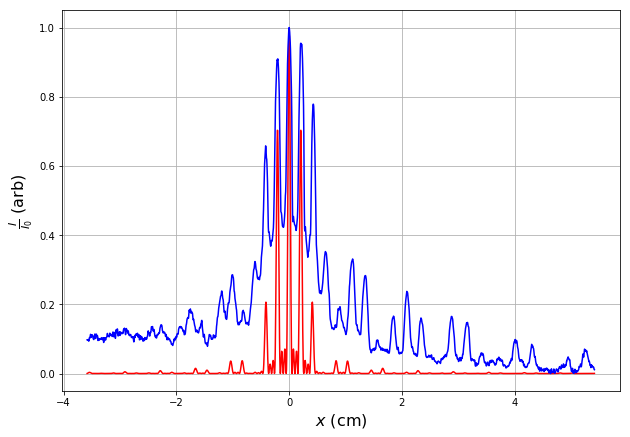

In [217]:
image = misc.imread('4slit.png', mode = 'L').mean(axis = 0)
image = image - min(image)
image = image/max(image)
m = 4.5
y = np.linspace(-m, m, len(image))
y = y - y[np.argmax(image)]
a = 0.04e-1
b = 0.125e-1
N = 4
I = nslits(a, y, 41., 632.8e-7, N, b)
fig, ax = plt.subplots(figsize = (10, 7))
ax.plot(y, I, c = 'red')
ax.plot(y, image, c = 'blue')
ax.set_xlabel(r'$x$ (cm)', fontsize = 16)
ax.set_ylabel(r'$\frac{I}{I_0}$ (arb)', fontsize = 16)
ax.grid(True)
plt.show()

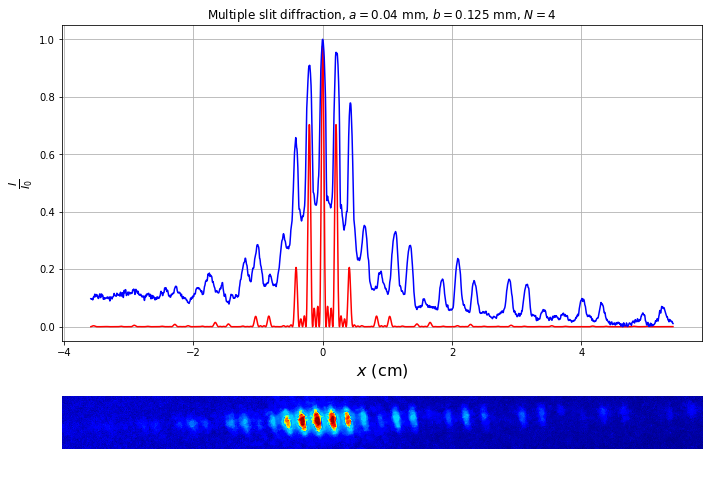

In [218]:
fig = plt.figure(figsize = (10, 7))
gspec = gs.GridSpec(2, 1, height_ratios = [4, 1])
ax0 = plt.subplot(gspec[0])
ax1 = plt.subplot(gspec[1])
ax0.plot(y, I, c = 'red')
ax0.plot(y, image, c = 'blue')
ax0.set_ylabel(r'$\frac{I}{I_0}$', fontsize = 16)
ax0.set_xlabel(r'$x$ (cm)', fontsize = 16)
ax0.grid(True)
ax0.set_title(r'Multiple slit diffraction, $a=0.04$ mm, $b=0.125$ mm, $N=4$')
ax1.imshow(misc.imread('4slit.png', mode = 'L'), cmap = 'jet')
ax1.set_axis_off()
ax1.set_xlabel(r'$x$ (cm)', fontsize = 16)
plt.tight_layout()
plt.show()

/usr/local/anaconda2/lib/python2.7/site-packages/ipykernel_launcher.py:3: RuntimeWarning: invalid value encountered in divide
  This is separate from the ipykernel package so we can avoid doing imports until


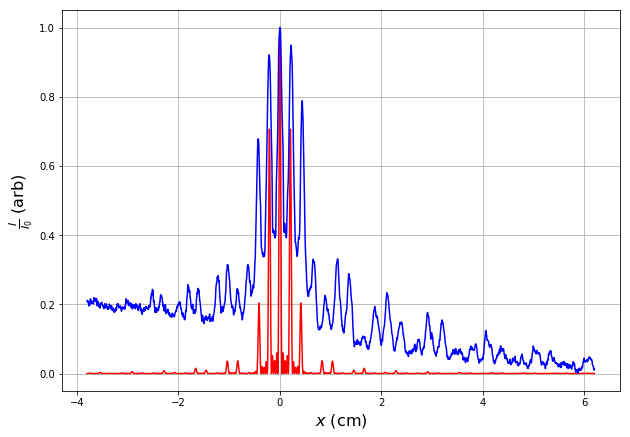

In [219]:
image = misc.imread('5slit.png', mode = 'L').mean(axis = 0)
image = image - min(image)
image = image/max(image)
m = 5
y = np.linspace(-m, m, len(image))
y = y - y[np.argmax(image)]
a = 0.04e-1
b = 0.125e-1
N = 5
I = nslits(a, y, 41., 632.8e-7, N, b)
fig, ax = plt.subplots(figsize = (10, 7))
ax.plot(y, I, c = 'red')
ax.plot(y, image, c = 'blue')
ax.set_xlabel(r'$x$ (cm)', fontsize = 16)
ax.set_ylabel(r'$\frac{I}{I_0}$ (arb)', fontsize = 16)
ax.grid(True)
plt.show()

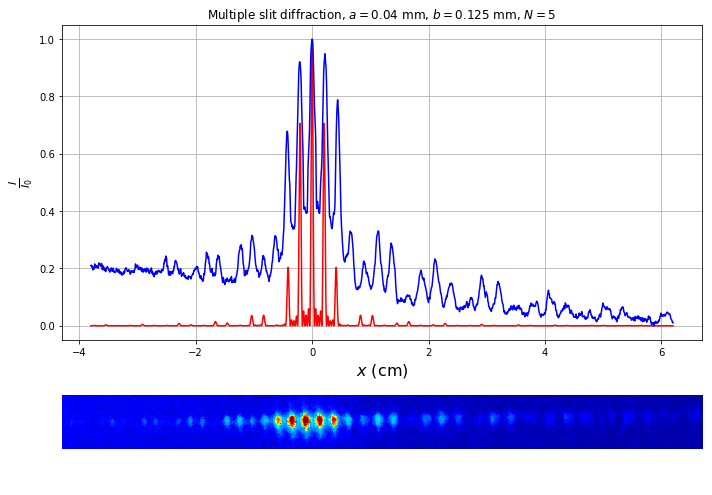

In [220]:
fig = plt.figure(figsize = (10, 7))
gspec = gs.GridSpec(2, 1, height_ratios = [4, 1])
ax0 = plt.subplot(gspec[0])
ax1 = plt.subplot(gspec[1])
ax0.plot(y, I, c = 'red')
ax0.plot(y, image, c = 'blue')
ax0.set_ylabel(r'$\frac{I}{I_0}$', fontsize = 16)
ax0.set_xlabel(r'$x$ (cm)', fontsize = 16)
ax0.grid(True)
ax0.set_title(r'Multiple slit diffraction, $a=0.04$ mm, $b=0.125$ mm, $N=5$')
ax1.imshow(misc.imread('5slit.png', mode = 'L'), cmap = 'jet')
ax1.set_axis_off()
ax1.set_xlabel(r'$x$ (cm)', fontsize = 16)
plt.tight_layout()
plt.show()

In [67]:
def circular(a, y, d, l):
    alpha = y/np.sqrt(y**2+d**2)
    k = 2*pi/l
    beta = k*a*alpha
    I = (2*jv(1, beta)/beta)**2
    return I

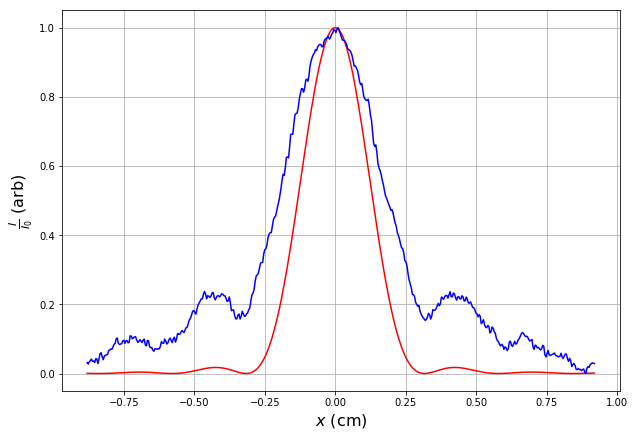

In [221]:
image = misc.imread('circular.1mm.png', mode = 'L').mean(axis = 0)
image = image - min(image)
image = image/max(image)
m = 0.9
y = np.linspace(-m, m, len(image))
y = y - y[np.argmax(image)] + 0.01
a = 0.05e-1
I = circular(a, y, d, l)
fig, ax = plt.subplots(figsize = (10, 7))
ax.plot(y, I, c = 'red')
ax.plot(y, image, c = 'blue')
ax.set_xlabel(r'$x$ (cm)', fontsize = 16)
ax.set_ylabel(r'$\frac{I}{I_0}$ (arb)', fontsize = 16)
ax.grid(True)
plt.show()

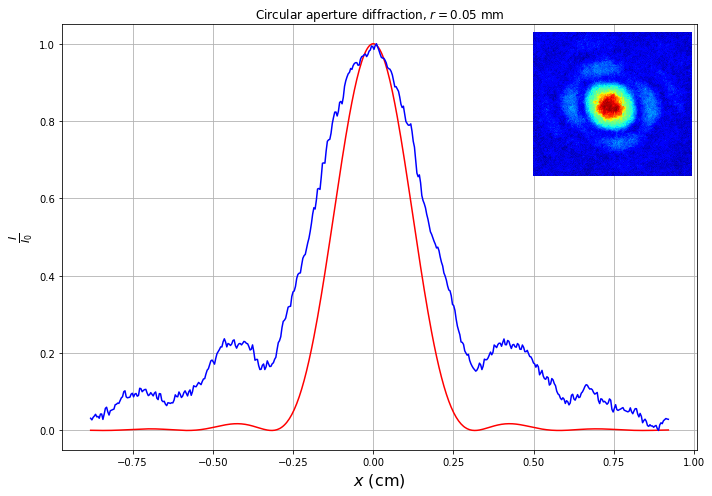

In [222]:
fig, ax = plt.subplots(figsize = (10, 7))
ax.plot(y, I, c = 'red')
ax.plot(y, image, c = 'blue')
ax.set_ylabel(r'$\frac{I}{I_0}$', fontsize = 16)
ax.set_xlabel(r'$x$ (cm)', fontsize = 16)
ax.grid(True)
ax.set_title(r'Circular aperture diffraction, $r=0.05$ mm')
axin = inset_axes(ax, width = '25%', height = '35%', loc = 1)
axin.imshow(misc.imread('circular.1mm.png', mode = 'L'), cmap = 'jet')
axin.set_axis_off()
plt.tight_layout()
plt.show()

/usr/local/anaconda2/lib/python2.7/site-packages/ipykernel_launcher.py:5: RuntimeWarning: invalid value encountered in divide
  """


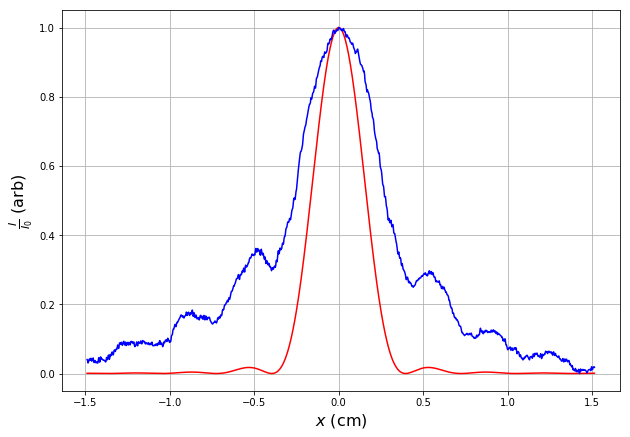

In [223]:
image = misc.imread('circular.08mm.png', mode = 'L').mean(axis = 0)
image = image - min(image)
image = image/max(image)
m = 1.5
y = np.linspace(-m, m, len(image))
y = y - y[np.argmax(image)]
a = 0.04e-1
I = circular(a, y, d, l)
fig, ax = plt.subplots(figsize = (10, 7))
ax.plot(y, I, c = 'red')
ax.plot(y, image, c = 'blue')
ax.set_xlabel(r'$x$ (cm)', fontsize = 16)
ax.set_ylabel(r'$\frac{I}{I_0}$ (arb)', fontsize = 16)
ax.grid(True)
plt.show()

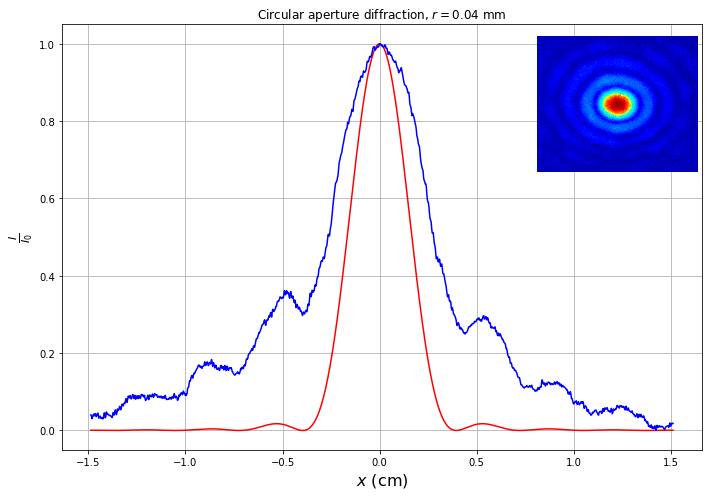

In [224]:
fig, ax = plt.subplots(figsize = (10, 7))
ax.plot(y, I, c = 'red')
ax.plot(y, image, c = 'blue')
ax.set_ylabel(r'$\frac{I}{I_0}$', fontsize = 16)
ax.set_xlabel(r'$x$ (cm)', fontsize = 16)
ax.grid(True)
ax.set_title(r'Circular aperture diffraction, $r=0.04$ mm')
axin = inset_axes(ax, width = '25%', height = '35%', loc = 1)
axin.imshow(misc.imread('circular.08mm.png', mode = 'L'), cmap = 'jet')
axin.set_axis_off()
plt.tight_layout()
plt.show()

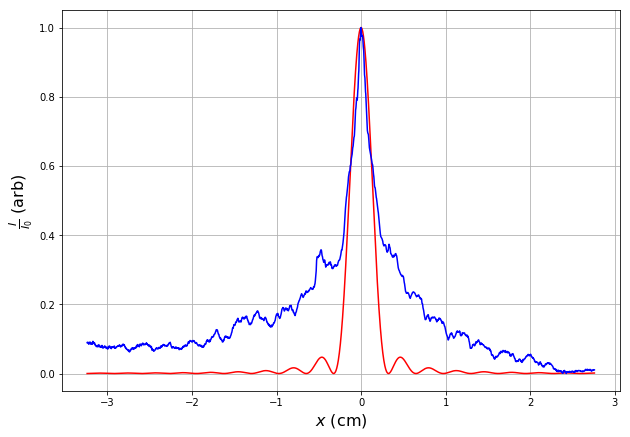

In [225]:
image = misc.imread('wire80um.png', mode = 'L').mean(axis = 0)
image = image - min(image)
image = image/max(image)
m = 3.
y = np.linspace(-m, m, len(image))
y = y - y[np.argmax(image)]
a = 80e-4
I = singleslit(80e-4, y, 41., 632.8e-7)
fig, ax = plt.subplots(figsize = (10, 7))
ax.plot(y, I, c = 'red')
ax.plot(y, image, c = 'blue')
ax.set_xlabel(r'$x$ (cm)', fontsize = 16)
ax.set_ylabel(r'$\frac{I}{I_0}$ (arb)', fontsize = 16)
ax.grid(True)
plt.show()

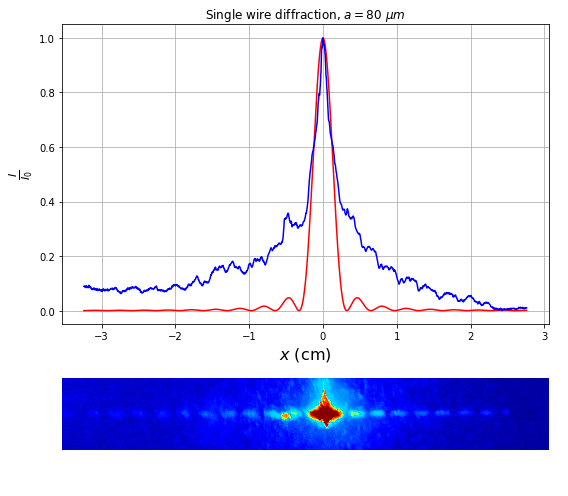

In [227]:
fig = plt.figure(figsize = (8, 7))
gspec = gs.GridSpec(2, 1, height_ratios = [4, 1])
ax0 = plt.subplot(gspec[0])
ax1 = plt.subplot(gspec[1])
ax0.plot(y, I, c = 'red')
ax0.plot(y, image, c = 'blue')
ax0.set_ylabel(r'$\frac{I}{I_0}$', fontsize = 16)
ax0.set_xlabel(r'$x$ (cm)', fontsize = 16)
ax0.set_title(r'Single wire diffraction, $a=80$ $\mu m$')
ax0.grid(True)
ax1.imshow(misc.imread('wire80um.png', mode = 'L'), cmap = 'jet')
ax1.set_axis_off()
ax1.set_xlabel(r'$x$ (cm)', fontsize = 16)
plt.tight_layout()
plt.show()

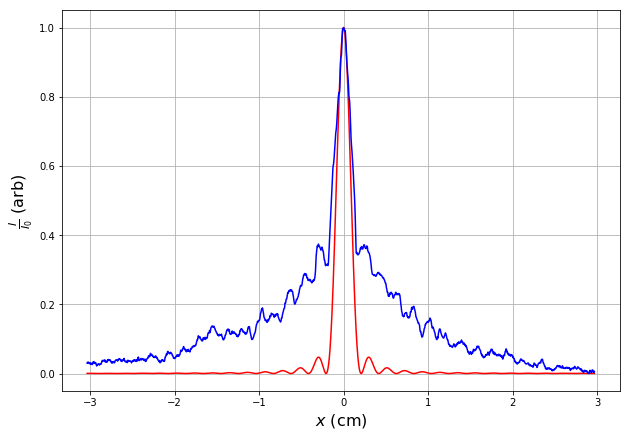

In [228]:
image = misc.imread('wire125um.png', mode = 'L').mean(axis = 0)
image = image - min(image)
image = image/max(image)
m = 3.
y = np.linspace(-m, m, len(image))
y = y - y[np.argmax(image)]
a = 125e-4
I = singleslit(a, y, 41., 632.8e-7)
fig, ax = plt.subplots(figsize = (10, 7))
ax.plot(y, I, c = 'red')
ax.plot(y, image, c = 'blue')
ax.set_xlabel(r'$x$ (cm)', fontsize = 16)
ax.set_ylabel(r'$\frac{I}{I_0}$ (arb)', fontsize = 16)
ax.grid(True)
plt.show()

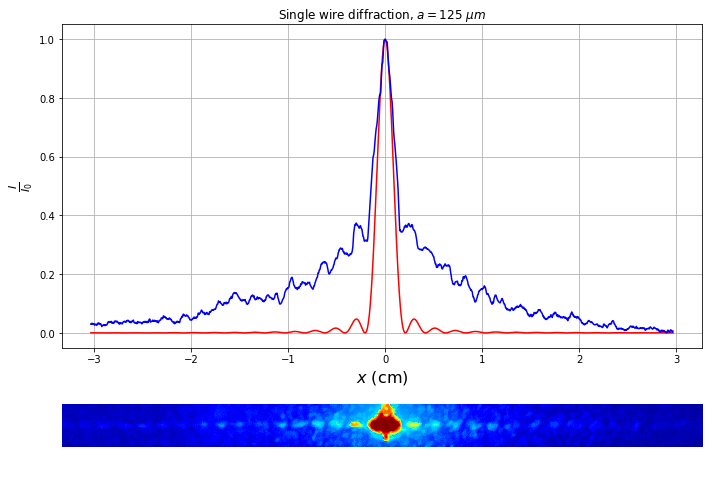

In [229]:
fig = plt.figure(figsize = (10, 7))
gspec = gs.GridSpec(2, 1, height_ratios = [4, 1])
ax0 = plt.subplot(gspec[0])
ax1 = plt.subplot(gspec[1])
ax0.plot(y, I, c = 'red')
ax0.plot(y, image, c = 'blue')
ax0.set_ylabel(r'$\frac{I}{I_0}$', fontsize = 16)
ax0.set_xlabel(r'$x$ (cm)', fontsize = 16)
ax0.grid(True)
ax0.set_title(r'Single wire diffraction, $a=125$ $\mu m$')
ax1.imshow(misc.imread('wire125um.png', mode = 'L'), cmap = 'jet')
ax1.set_axis_off()
ax1.set_xlabel(r'$x$ (cm)', fontsize = 16)
plt.tight_layout()
plt.show()

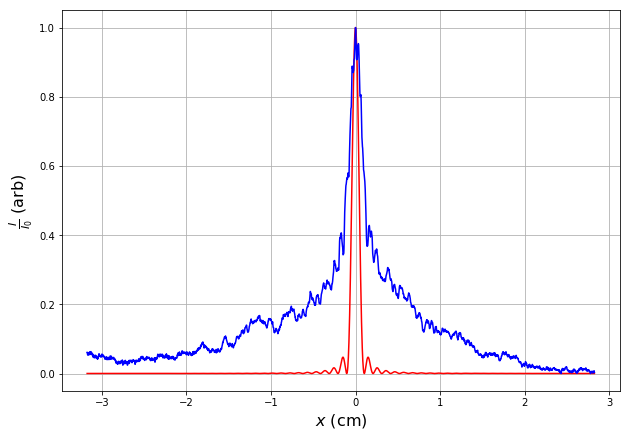

In [230]:
image = misc.imread('wire250um.png', mode = 'L').mean(axis = 0)
image = image - min(image)
image = image/max(image)
m = 3.
y = np.linspace(-m, m, len(image))
y = y - y[np.argmax(image)]
a = 250e-4
I = singleslit(a, y, 41., 632.8e-7)
fig, ax = plt.subplots(figsize = (10, 7))
ax.plot(y, I, c = 'red')
ax.plot(y, image, c = 'blue')
ax.set_xlabel(r'$x$ (cm)', fontsize = 16)
ax.set_ylabel(r'$\frac{I}{I_0}$ (arb)', fontsize = 16)
ax.grid(True)
plt.show()

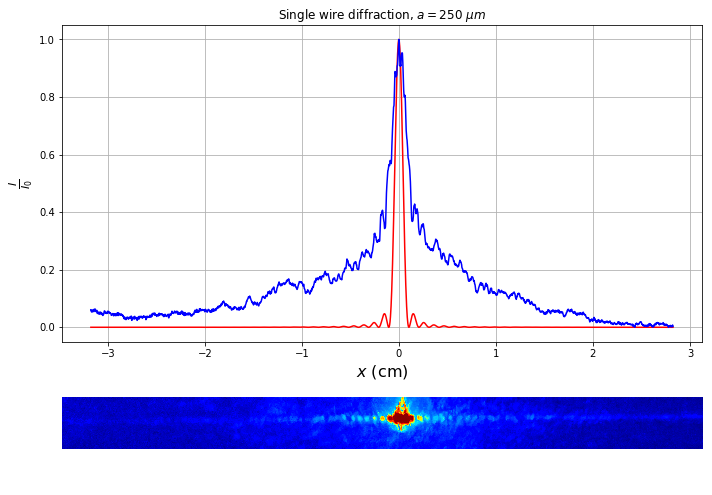

In [231]:
fig = plt.figure(figsize = (10, 7))
gspec = gs.GridSpec(2, 1, height_ratios = [4, 1])
ax0 = plt.subplot(gspec[0])
ax1 = plt.subplot(gspec[1])
ax0.plot(y, I, c = 'red')
ax0.plot(y, image, c = 'blue')
ax0.set_ylabel(r'$\frac{I}{I_0}$', fontsize = 16)
ax0.set_xlabel(r'$x$ (cm)', fontsize = 16)
ax0.grid(True)
ax0.set_title(r'Single wire diffraction, $a=250$ $\mu m$')
ax1.imshow(misc.imread('wire250um.png', mode = 'L'), cmap = 'jet')
ax1.set_axis_off()
ax1.set_xlabel(r'$x$ (cm)', fontsize = 16)
plt.tight_layout()
plt.show()

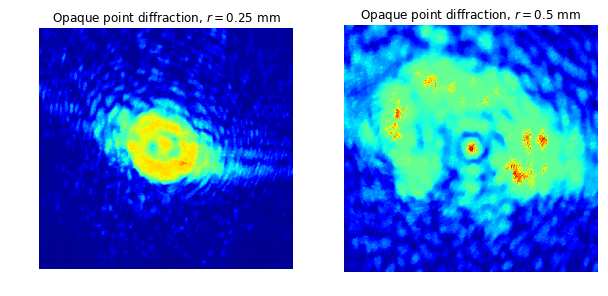

In [232]:
fig, ax = plt.subplots(1, 2, figsize = (10, 7))
ax[0].imshow(misc.imread('oppoint.25mm2.png', mode = 'L'), cmap = 'jet')
ax[0].set_axis_off()
ax[0].set_title(r'Opaque point diffraction, $r=0.25$ mm')
ax[1].imshow(misc.imread('oppoint.5mm.png', mode = 'L'), cmap = 'jet')
ax[1].set_title(r'Opaque point diffraction, $r=0.5$ mm')
ax[1].set_axis_off()
plt.show()

In [233]:
os.chdir('/home/gian/Documents/School/Grad School/Fall 2017/PHYS 3330/Lab 5/Plots/')

In [238]:
plots = sorted(glob.glob('*.png'))
plots

['2slit.png',
 '3slit.png',
 '4slit.png',
 '5slit.png',
 'circular.04mm.png',
 'circular.05mm.png',
 'singleslit.02mm.png',
 'singleslit.04mm.png',
 'singleslit.08mm.png',
 'wire125um.png',
 'wire250um.png',
 'wire80um.png']

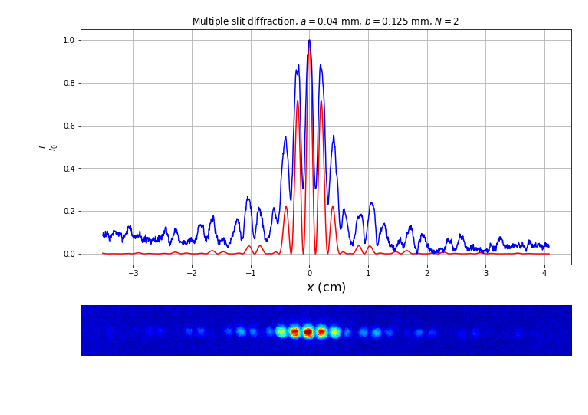

In [243]:
plt.figure(figsize = (10, 7))
plt.imshow(mpimg.imread(plots[0]))
plt.axis('off')
plt.show()

5B: Diffraction grating

In [264]:
def wave(d, m, s, L):
    return d*s/(m*(s**2+4*L**2)**0.5)

In [294]:
L = unc.ufloat(8.4, 0.1)
s1 = unc.ufloat(7., 0.1)
s2 = unc.ufloat(20.7, 0.1)
d = 1e-1/600.

In [295]:
l1 = wave(d, 1, s1, L)
l1*1e7

641.0256410256411+/-10.157031895320445

In [296]:
l2 = wave(d, 2, s2, L)
l2*1e7

647.0484119917621+/-3.301209529669128

In [268]:
(l1 + l2)/2*1e7

639.2880239727857+/-6.137450051468503

5C: Talbot Effect

In [297]:
def talbotread(n):
    image = misc.imread('talbot'+str(n)+'.png', mode = 'L')
    image = image - np.min(image)
    return image

In [317]:
def mse(imageA, imageB):
    # the 'Mean Squared Error' between the two images is the
    # sum of the squared difference between the two images;
    # NOTE: the two images must have the same dimension
    err = np.sum((imageA.astype("float") - imageB.astype("float")) ** 2)
    err /= float(imageA.shape[0] * imageA.shape[1])
    
    # return the MSE, the lower the error, the more "similar"
    # the two images are
    return err
 
def compare_images(imageA, imageB, title):
    # compute the mean squared error and structural similarity
    # index for the images
    m = mse(imageA, imageB)
    s = compare_ssim(imageA, imageB)
 
    # setup the figure
    fig = plt.figure(title)
    plt.suptitle("MSE: %.2f, SSIM: %.2f" % (m, s))

    # show first image
    ax = fig.add_subplot(1, 2, 1)
    plt.imshow(imageA, cmap = plt.cm.gray)
    plt.axis("off")
 
    # show the second image
    ax = fig.add_subplot(1, 2, 2)
    plt.imshow(imageB, cmap = plt.cm.gray)
    plt.axis("off")
 
    # show the images
    plt.show()

In [321]:
tlist = []
for n in range(2,11):
    tlist.append(misc.imresize(talbotread(n), (1344, 1612)))

In [322]:
simlist = []
for i in range(len(tlist)):
    sim = []
    for n in range(len(tlist)):
        sim.append(compare_ssim(tlist[i], tlist[n]))
    simlist.append(sim)

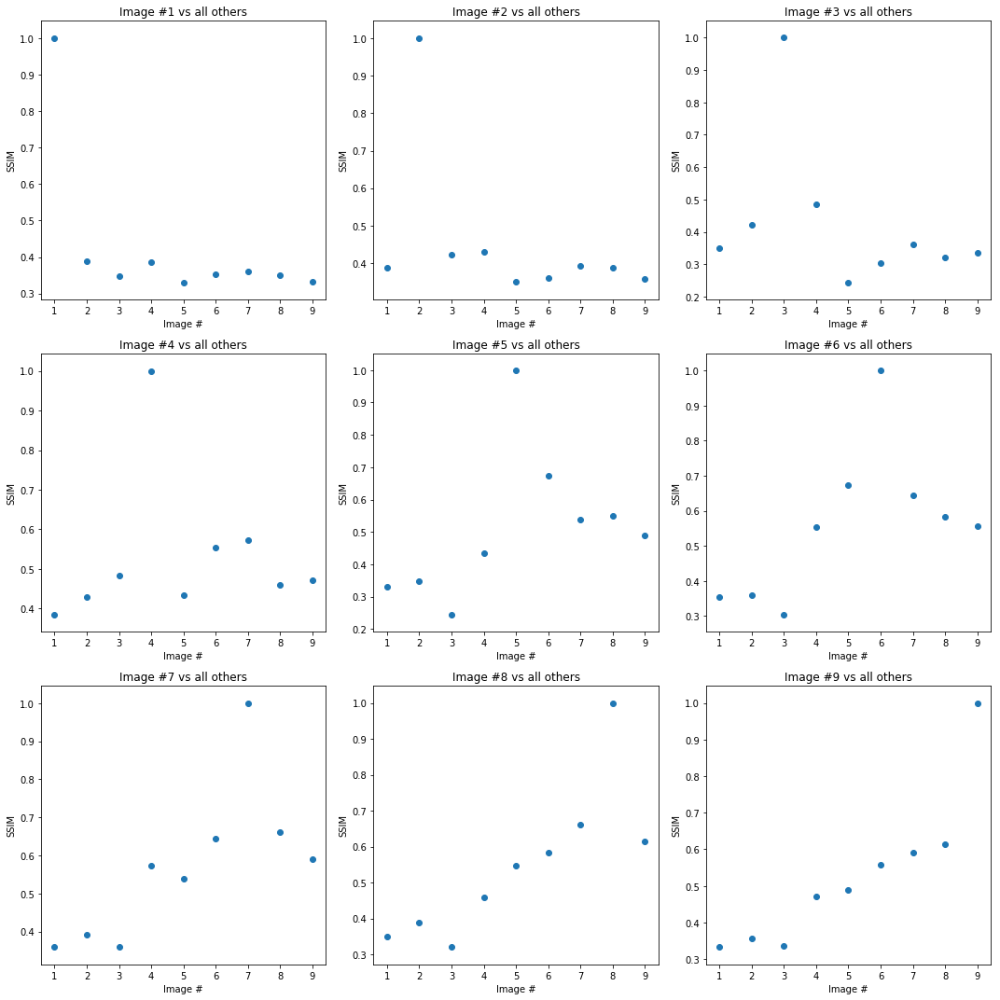

In [323]:
f, axarr = plt.subplots(3, 3, figsize = (15, 15))
c1 = 0
c2 = 0
c3 = 1
x = np.linspace(1, 9, 9)
for sim in simlist:
    axarr[c1, c2].scatter(x, sim)
    axarr[c1, c2].set_xlabel('Image #')
    axarr[c1, c2].set_ylabel('SSIM')
    axarr[c1, c2].xaxis.set_ticks(x)
    axarr[c1, c2].set_title('Image #' + str(c3) + ' vs all others')
    c3 = c3 + 1
    if c2 != 2:
        c2 = c2 + 1
    else:
        c1 = c1 + 1
        c2 = 0
plt.tight_layout()
plt.show()

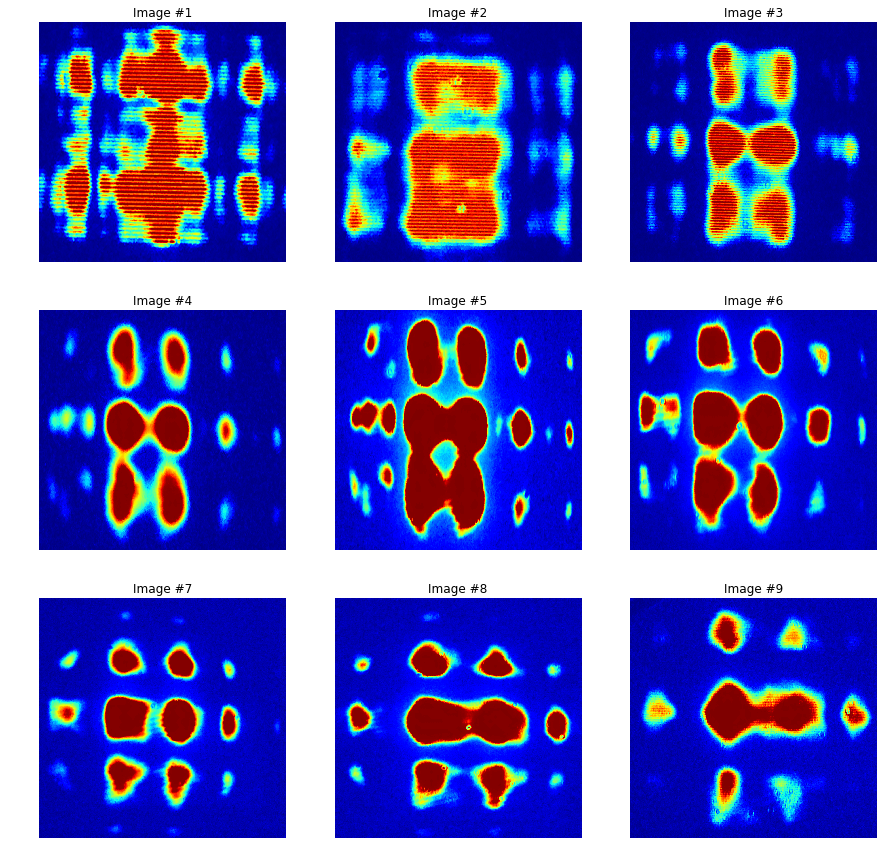

In [324]:
f, axarr = plt.subplots(3, 3, figsize = (15, 15))
c1 = 0
c2 = 0
c3 = 1
for t in tlist:
    im = axarr[c1, c2].imshow(t, cmap = 'jet', origin = 'lower', aspect = 'auto')
    axarr[c1, c2].set_axis_off()
    axarr[c1, c2].set_title('Image #' + str(c3))
    c3 = c3 + 1
    if c2 != 2:
        c2 = c2 + 1
    else:
        c1 = c1 + 1
        c2 = 0
plt.show()

5D: Fourier Optics

In [343]:
def fourierread(name):
    image = misc.imread(name, mode = 'L').astype(float)
    return image

@jit(nopython = True)
def circle(a, b, r, s):
    m = np.ones(s)
    for x in range(-len(m)/2, len(m)/2):
        for y in range(-len(m[0])/2, len(m)/2):
            if (x-a)**2 + (y-b)**2 < r:
                m[x+len(m)/2][y+len(m[0])/2] = 0
    return m

def slit(width, height, s):
    x, y = s
    m = np.ones((width, height))
    m = np.pad(m, ((x/2 - width/2, x/2 - width/2), (y/2-height/2, y/2-height/2)), 'constant', constant_values=0)
    return m

def line(width, s):
    x, y = s
    m = np.zeros((width, y))
    m = np.pad(m, ((x/2 - width/2, x/2 - width/2), (0,0)), 'constant', constant_values=1)
    return m

def transform(name, aperture, unfiltered):
    im = unfiltered
    ori = np.flipud(fourierread(name))
    m = aperture
    a = fftshift(fft2(im))
    c = a * m
    d = ifft2(c)
    f, axarr = plt.subplots(1, 2, figsize = (20, 10))
    im1 = axarr[0].imshow(np.abs(d), origin = 'lower', aspect = 'auto', cmap = 'gray')
    im2 = axarr[1].imshow(ori, origin = 'lower', aspect = 'auto', cmap = 'gray')
    axarr[0].set_axis_off()
    axarr[1].set_axis_off()
    plt.tight_layout()
    plt.show()
    return

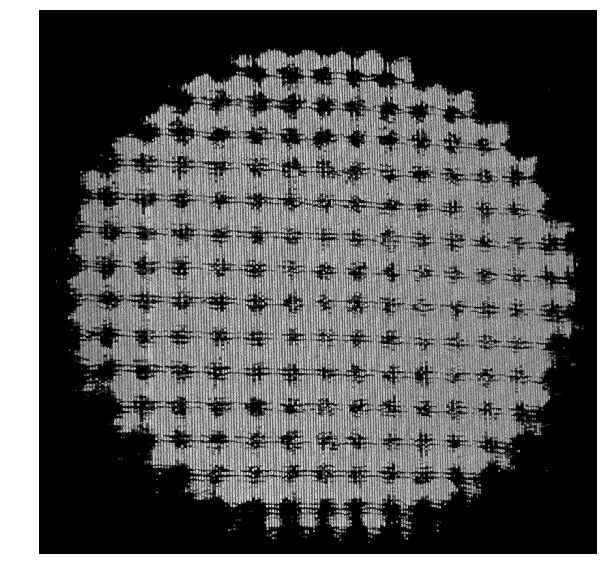

In [337]:
os.chdir('/home/gian/Documents/School/Grad School/Fall 2017/PHYS 3330/Lab 5/Pics/Fourier/')
im = fourierread('wiremesh.JPG')
plt.figure(figsize = (10, 10))
plt.imshow(im.T, origin = 'lower', aspect = 'auto', cmap = 'gray')
plt.axis('off')
plt.show()

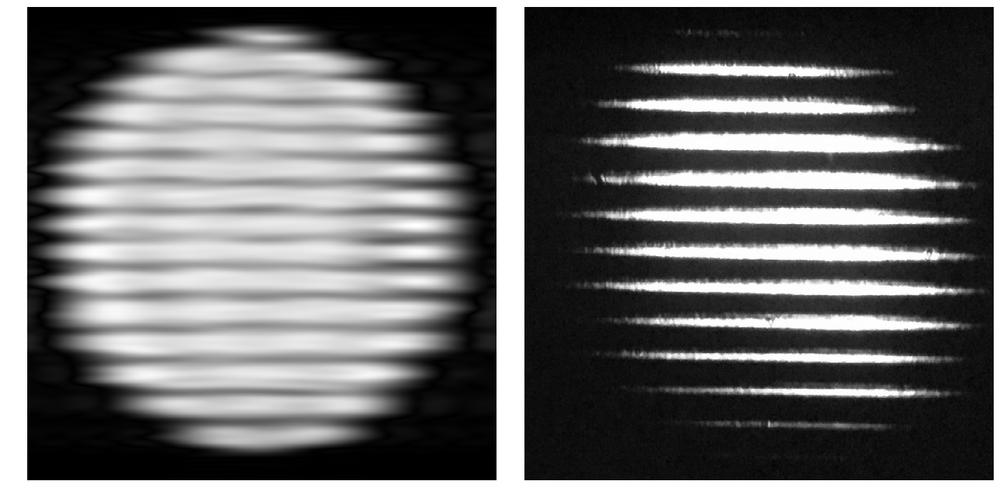

In [344]:
# slit
m = slit(100, 10, im.shape)
transform('Picture2.JPG', m, im)

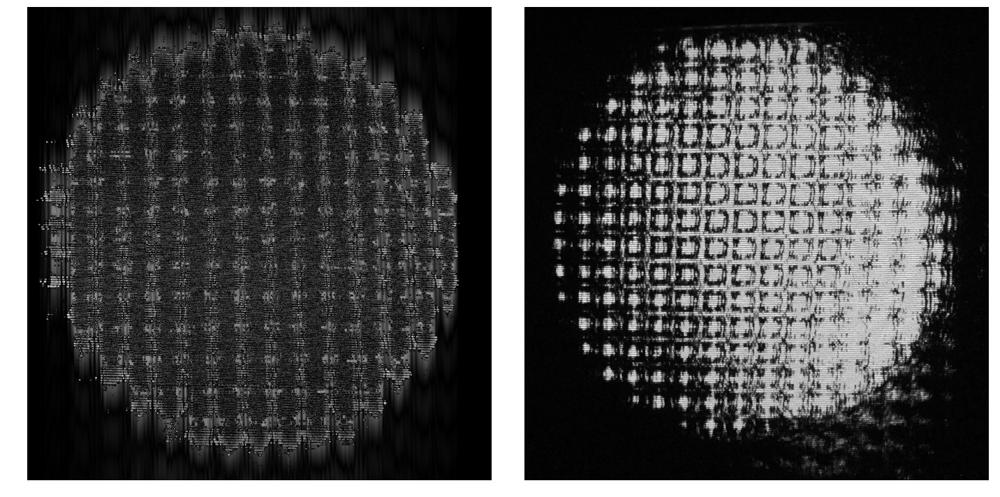

In [339]:
# line
m = line(10, im.shape)
transform('Picture4.JPG', m, im)

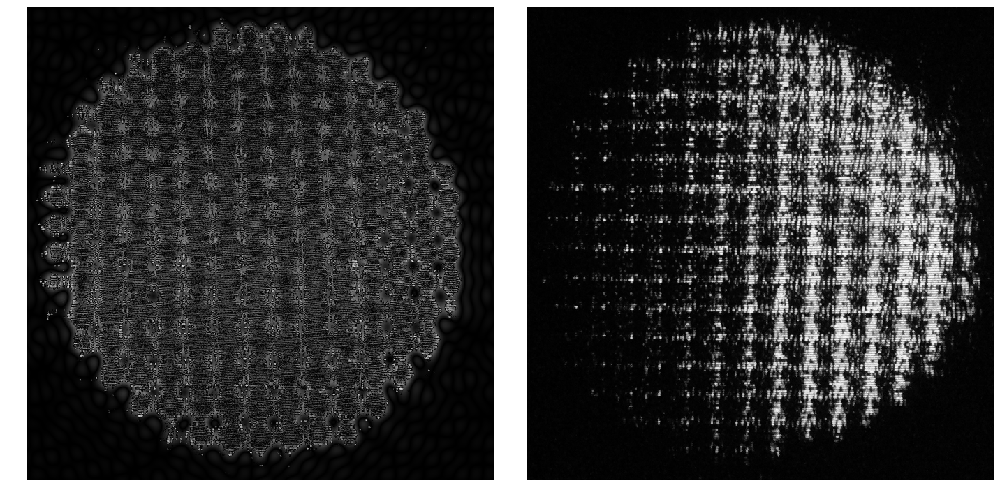

In [359]:
# opaque dot
m = circle(0, 0, 500, im.shape)
transform('opaquedot2.png', m, im)

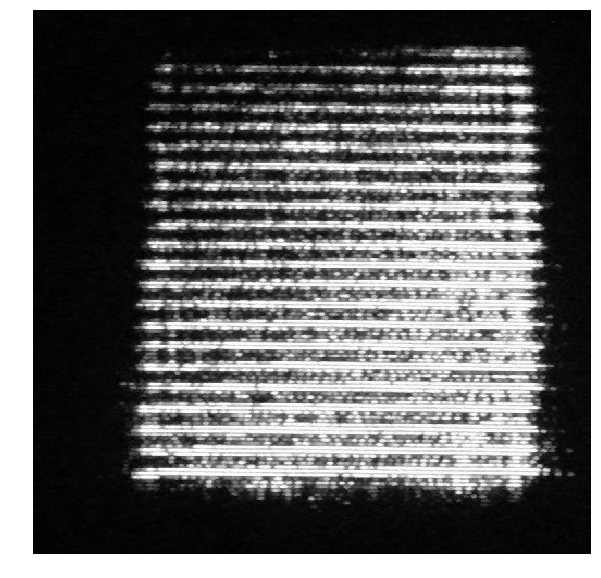

In [388]:
im = fourierread('Picture6.JPG')
plt.figure(figsize = (10, 10))
plt.imshow(im, origin = 'lower', aspect = 'auto', cmap = 'gray')
plt.axis('off')
plt.show()

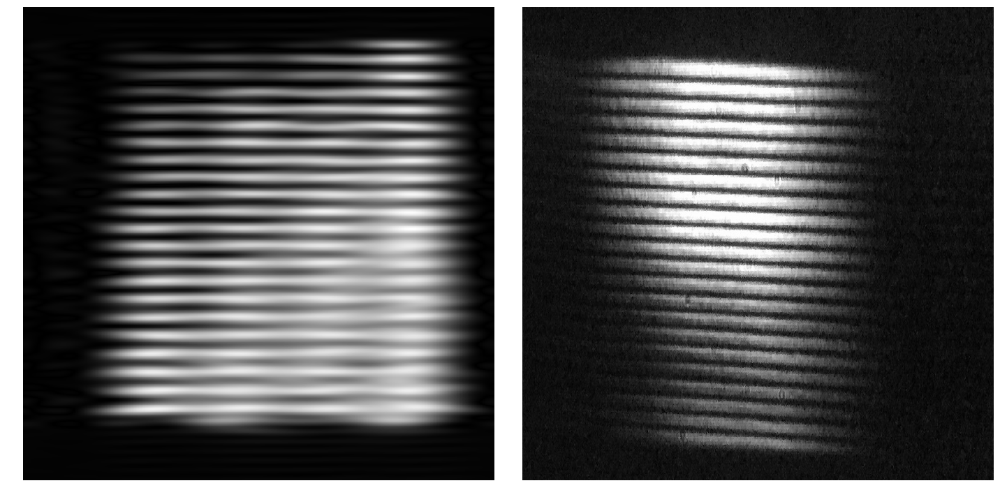

In [389]:
# slit
m = slit(101, 11, im.shape)
transform('Picture7.JPG', m, im)

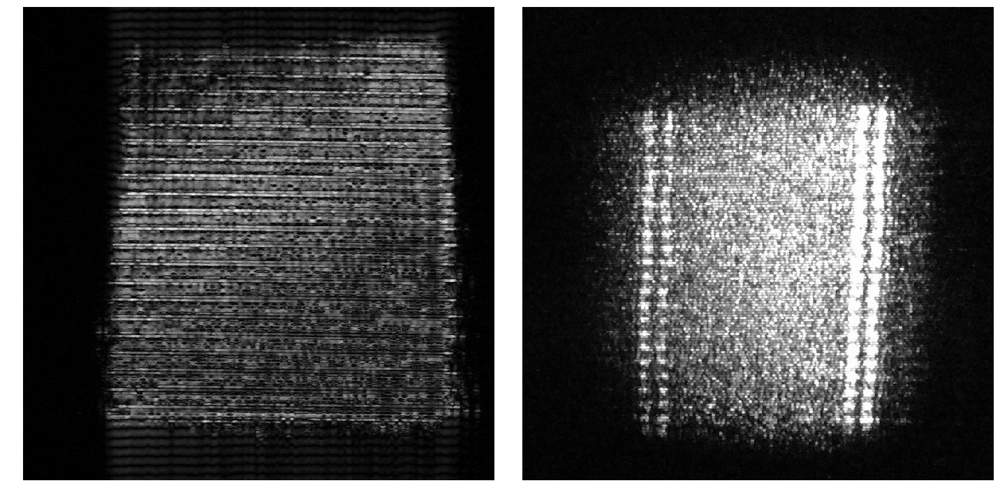

In [401]:
# line
m = line(51, im.shape)
transform('Picture8.JPG', m, im)

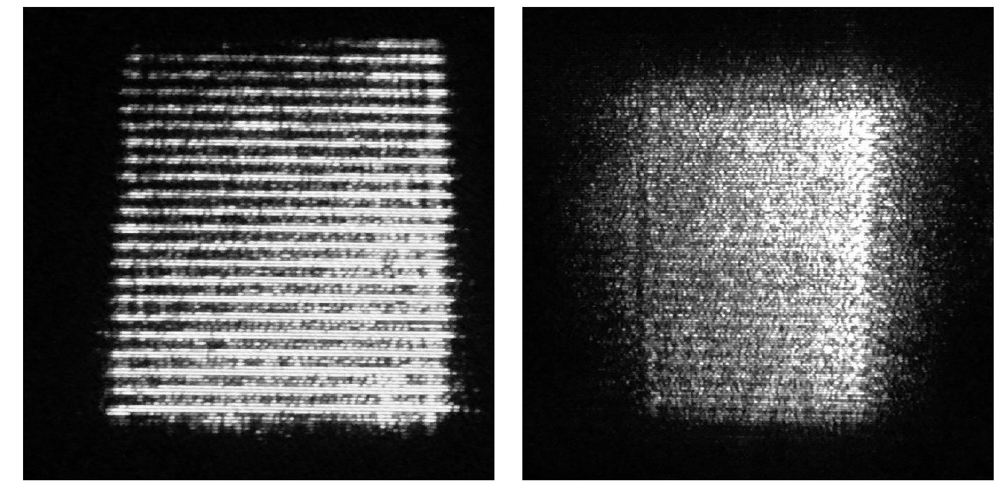

In [404]:
# opaque dot
m = circle(50, 50, 500, im.shape)
transform('Picture9.JPG', m, im)

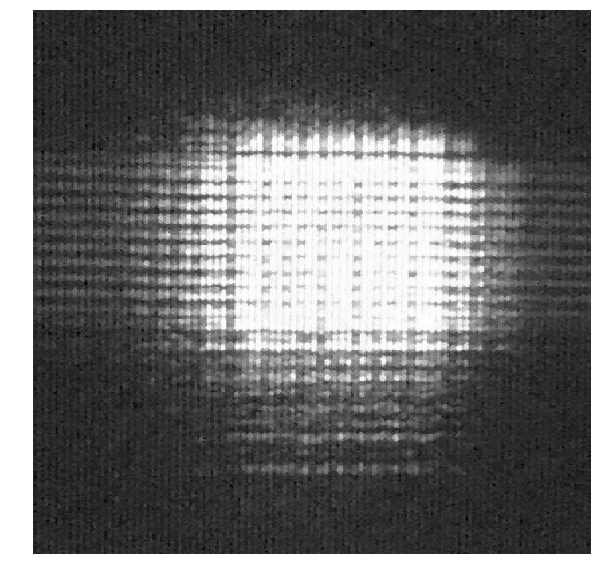

In [373]:
im = fourierread('Picture10.JPG')
plt.figure(figsize = (10, 10))
plt.imshow(im.T, origin = 'lower', aspect = 'auto', cmap = 'gray')
plt.axis('off')
plt.show()

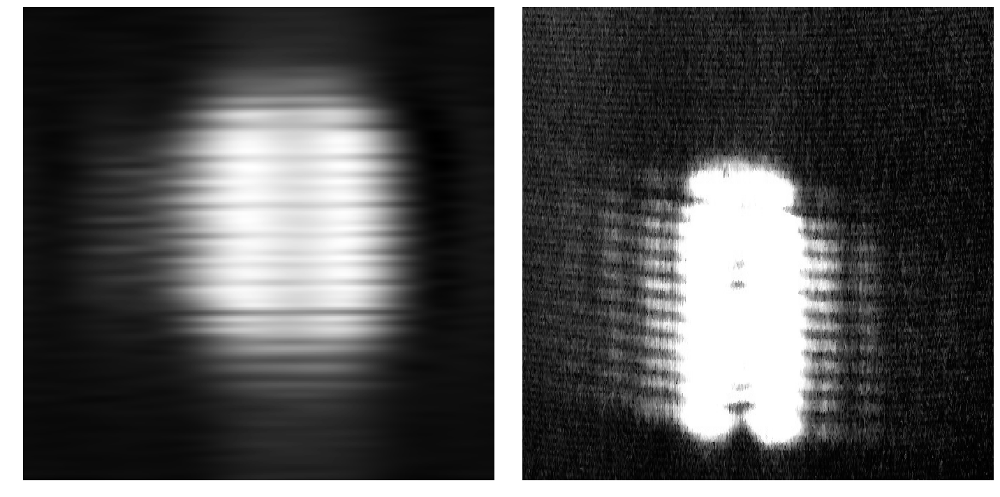

In [375]:
# slit
m = slit(100, 10, im.shape)
transform('Picture11.JPG', m, im)

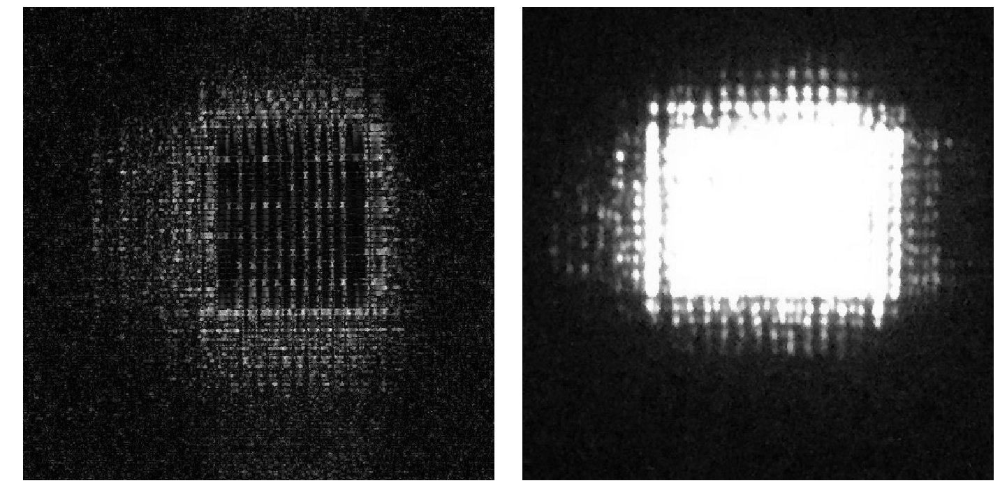

In [377]:
# line
m = line(10, im.shape)
transform('Picture12.JPG', m, im)

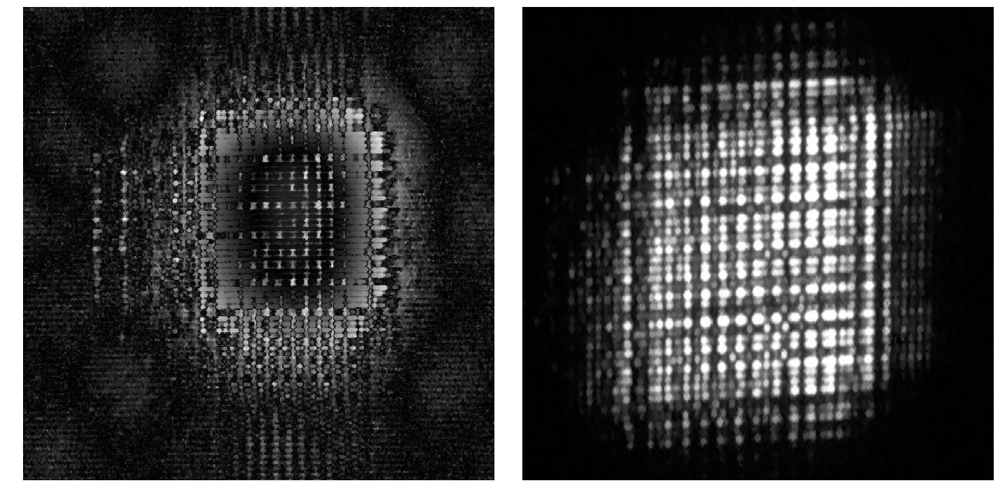

In [386]:
# opaque dot
m = circle(0, 0, 10, im.shape)
transform('Picture13.JPG', m, im)

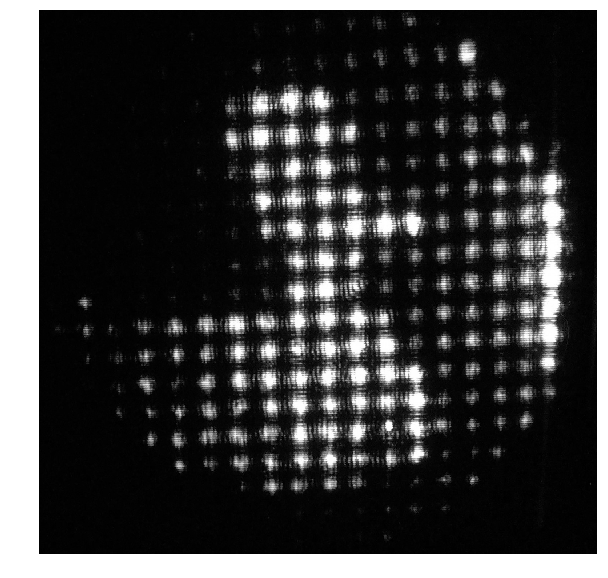

In [405]:
im = np.flipud(fourierread('Picture14.JPG'))
plt.figure(figsize = (10, 10))
plt.imshow(im, origin = 'lower', aspect = 'auto', cmap = 'gray')
plt.axis('off')
plt.show()

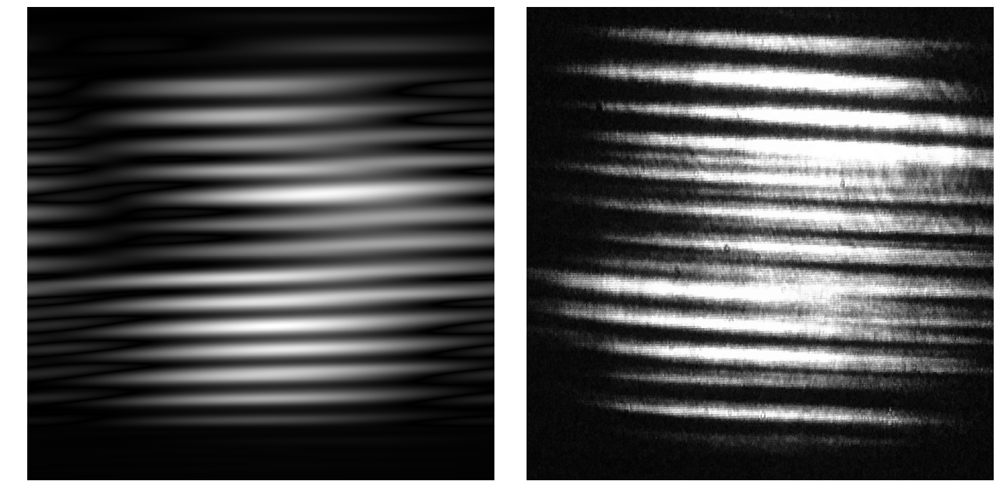

In [406]:
# slit 0.01 mm
m = slit(101, 3, im.shape)
transform('Picture15.JPG', m, im)

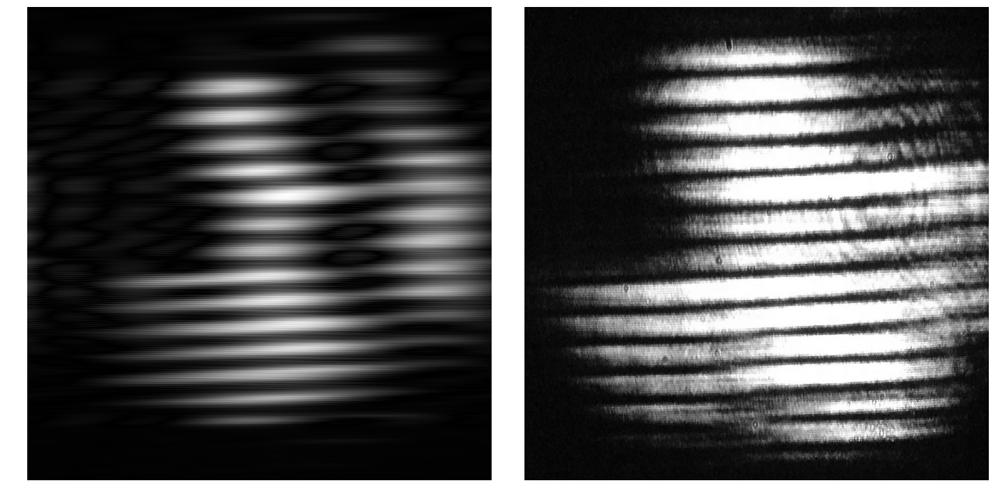

In [407]:
# slit 0.02 mm
m = slit(501, 7, im.shape)
transform('Picture16.JPG', m, im)

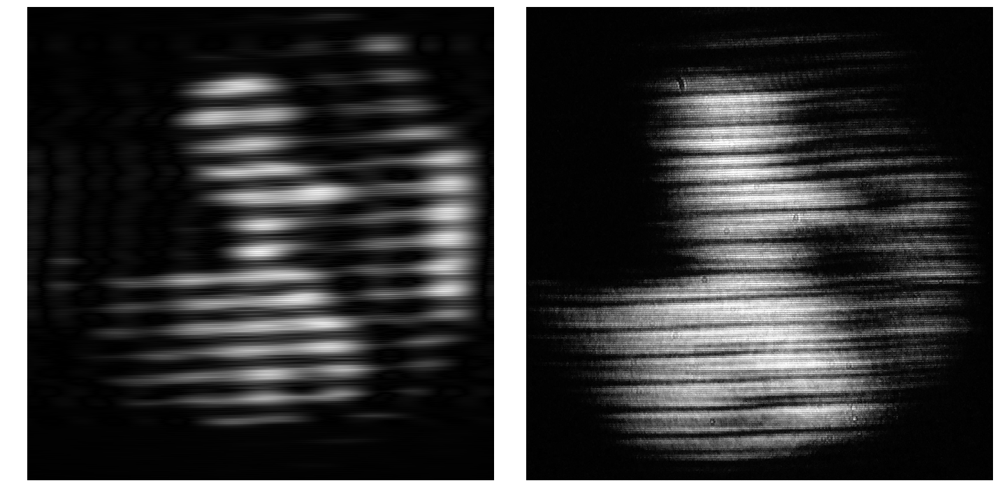

In [408]:
# slit 0.08 mm
m = slit(501, 15, im.shape)
transform('Picture17.JPG', m, im)

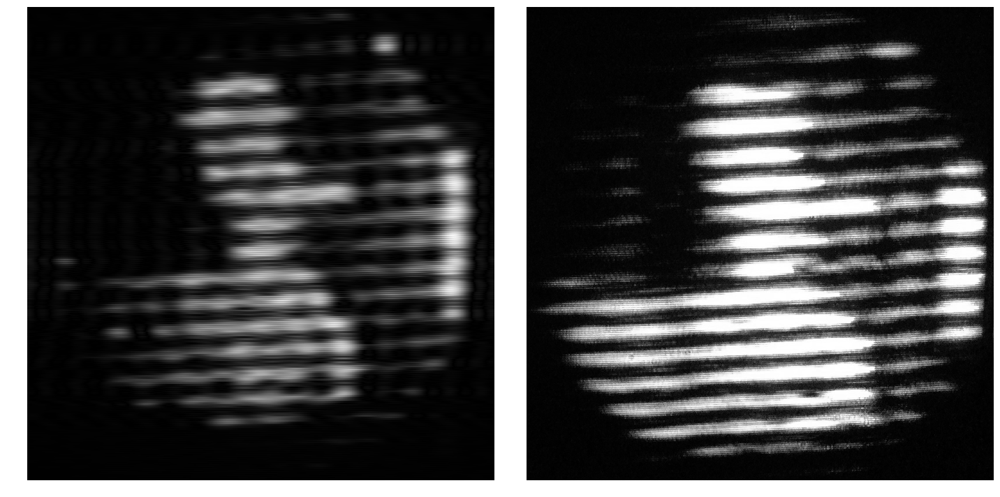

In [409]:
# slit 0.16 mm
m = slit(501, 29, im.shape)
transform('Picture18.JPG', m, im)

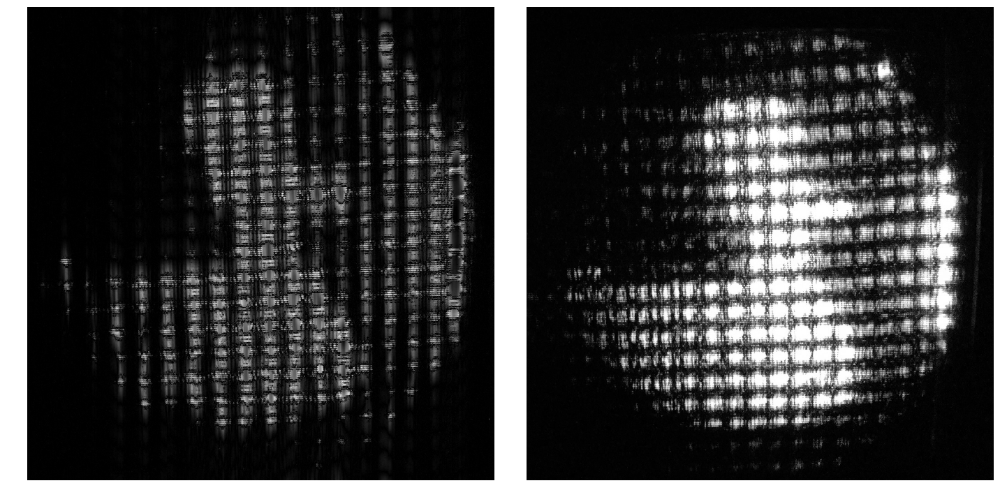

In [416]:
# line 250 um
m = line(21, im.shape)
transform('Picture19.JPG', m, im)

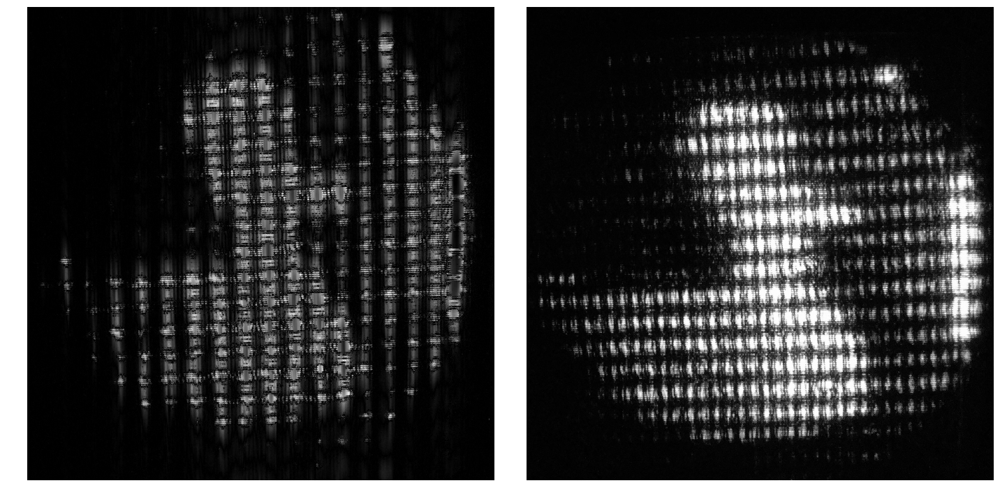

In [411]:
# line 125 um
m = line(15, im.shape)
transform('Picture20.JPG', m, im)

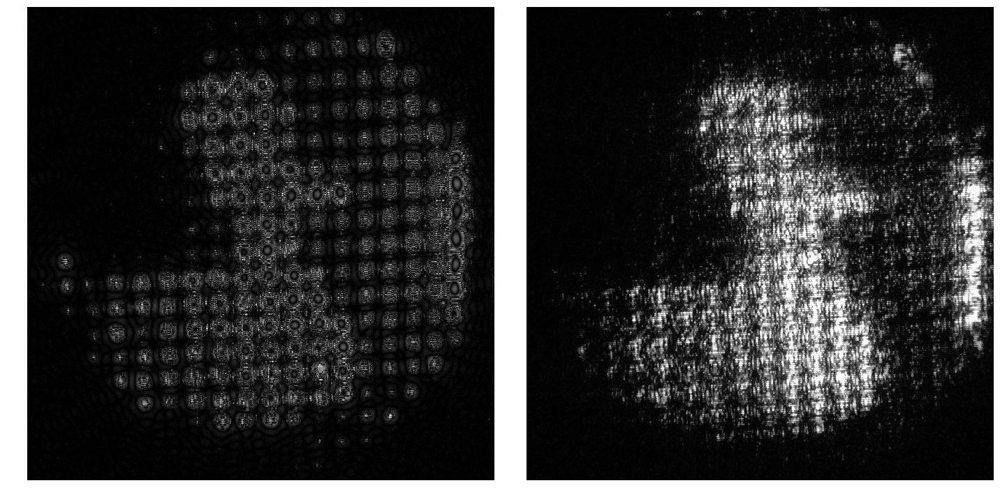

In [417]:
# opaque dot 1 mm
m = circle(0, 0, 1000, im.shape)
transform('Picture22.JPG', m, im)

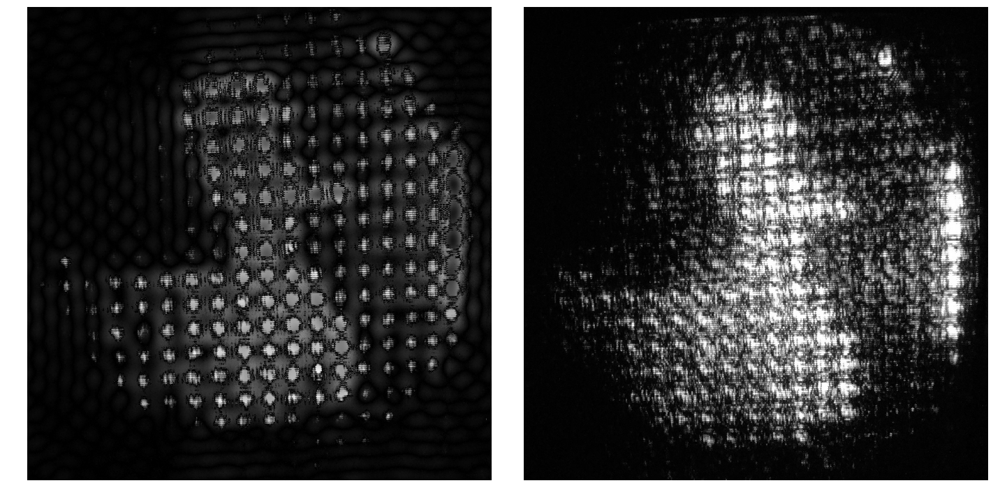

In [413]:
# opaque dot 0.5 mm
m = circle(0, 0, 300, im.shape)
transform('Picture23.JPG', m, im)